# Filling Algorithm Bench Mark Visualizations

## Functions, Data

In [1]:
import os
import pathlib

import numpy as np
import scipy as sp
import scipy.stats as sp_stats
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import seaborn as sns
import LZH_Utilities as utl

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [2]:
# Style
sns.set_style("whitegrid")

In [3]:
FC_OUTPUT_FOLDER_PATH = "Output/filling_comparison/"
FC_REAL_OUTPUT_FOLDER_PATH = "Output/filling_comparison_realistic/"

FC_REBUILD_OUTPUT_PATH = "Output/filling_comparison_training_with_rebuild_data/"

GRU_RVAL_FILE_PREFIX = "FILL_GRU_RVAL_"
FC_RVAL_FILE_PREFIX = "FILL_FC_RVAL_"
LINEAR_RVAL_FILE_PREFIX = "FILL_Linear_RVAL_"
MAE_FILE_PREFIX = "FILL_MAE_"
MSE_FILE_PREFIX = "FILL_MSE_"

REBUILD_STATS_FILE_PREFIX = "FILLING_REBUILDING_COMPARISON_STATS_"

In [4]:
def load_data(file_name):
    """
    return as dictionary that matches
    """
    ret_val = {}
    df = pd.read_csv(file_name)
    for col_name in df.columns:
        ret_val[col_name] = df[col_name].to_numpy()
    return ret_val

In [5]:
def load_dicts(prefix, path):
    dicts_fill = []
    for file_name in utl.filter_file_names(prefix, path):
        dicts_fill.append(load_data(path + file_name))
    return dicts_fill

In [6]:
def load_dfs(prefix, path):
    dicts_fill = []
    for file_name in utl.filter_file_names(prefix, path):
        dicts_fill.append(pd.read_csv(path + file_name))
    return dicts_fill

In [7]:
def sample_size(prefix, path):
    return len(utl.filter_file_names(prefix, path))

In [8]:
def plot_filling_benchmark_along_missing_data(dicts_fill, ylabel, title, ylim=None):
    percent_list = np.mean(np.stack([dict_fill["PercentMissing"] for dict_fill in dicts_fill]), axis=0)
    fill_mean = dict()
    for label in ["GRU", "Mean", "DailyMean", "DayNightMean", "Linear", "DayNightLinear", "Cubic"]:
        fill_mean[label] = np.mean(np.stack([dict_fill[label] for dict_fill in dicts_fill]), axis=0)

    plt.figure(figsize=[8, 6])
    plt.plot(percent_list, fill_mean["GRU"], "rx-")
    plt.plot(percent_list, fill_mean["Mean"], "bx-")
    plt.plot(percent_list, fill_mean["DailyMean"], "cx-")
    plt.plot(percent_list, fill_mean["DayNightMean"], "gx-")
    plt.plot(percent_list, fill_mean["Linear"], "mx-")
    plt.plot(percent_list, fill_mean["DayNightLinear"], "x-", color="tab:orange")
    plt.plot(percent_list, fill_mean["Cubic"], "x-", color="tab:olive")
    
    plt.xlabel("% Missing Data")
    plt.ylabel(ylabel)
    if (ylim is not None):
        plt.ylim(ylim)
    plt.legend(["GRU Fill", "Mean Fill", "Daily Mean Fill", "Day Night Mean Fill", "Linear Fill", "Day Night Linear Fill", "Cubic Spline Fill"])
    plt.title("{0}\nSample Size: {1}".format(title, len(dicts_fill)))
    plt.show()
    
def plot_filling_benchmark_along_missing_data_with_range(dicts_fill, ylabel, title, ylim=None):
    percent_list = np.mean(np.stack([dict_fill["PercentMissing"] for dict_fill in dicts_fill]), axis=0)
    fill_mean = dict()
    fill_min = dict()
    fill_max = dict()
    for label in ["GRU", "Mean", "DailyMean", "DayNightMean", "Linear", "DayNightLinear", "Cubic"]:
        fill_mean[label] = np.mean(np.stack([dict_fill[label] for dict_fill in dicts_fill]), axis=0)
        fill_min[label] = np.min(np.stack([dict_fill[label] for dict_fill in dicts_fill]), axis=0)
        fill_max[label] = np.max(np.stack([dict_fill[label] for dict_fill in dicts_fill]), axis=0)

    plt.figure(figsize=[8, 6])
    plt.plot(percent_list, fill_mean["GRU"], "rx-")
    plt.plot(percent_list, fill_mean["Mean"], "bx-")
    plt.plot(percent_list, fill_mean["DailyMean"], "cx-")
    plt.plot(percent_list, fill_mean["DayNightMean"], "gx-")
    plt.plot(percent_list, fill_mean["Linear"], "mx-")
    plt.plot(percent_list, fill_mean["DayNightLinear"], "x-", color="tab:orange")
    plt.plot(percent_list, fill_mean["Cubic"], "x-", color="tab:olive")
    
    plt.plot(percent_list, fill_min["GRU"], "r--", alpha=0.3)
    plt.plot(percent_list, fill_min["Mean"], "b--", alpha=0.3)
    plt.plot(percent_list, fill_min["DailyMean"], "c--", alpha=0.3)
    plt.plot(percent_list, fill_min["DayNightMean"], "g--", alpha=0.3)
    plt.plot(percent_list, fill_min["Linear"], "m--", alpha=0.1)
    plt.plot(percent_list, fill_min["DayNightLinear"], "--", color="tab:orange", alpha=0.3)
    plt.plot(percent_list, fill_min["Cubic"], "--", color="tab:olive", alpha=0.3)
    
    plt.plot(percent_list, fill_max["GRU"], "r--", alpha=0.3)
    plt.plot(percent_list, fill_max["Mean"], "b--", alpha=0.3)
    plt.plot(percent_list, fill_max["DailyMean"], "c--", alpha=0.3)
    plt.plot(percent_list, fill_max["DayNightMean"], "g--", alpha=0.3)
    plt.plot(percent_list, fill_max["Linear"], "m--", alpha=0.3)
    plt.plot(percent_list, fill_max["DayNightLinear"], "--", color="tab:orange", alpha=0.3)
    plt.plot(percent_list, fill_max["Cubic"], "--", color="tab:olive", alpha=0.3)
    
    
    plt.xlabel("% Missing Data")
    plt.ylabel(ylabel)
    if (ylim is not None):
        plt.ylim(ylim)
    plt.legend(["GRU Fill", "Mean Fill", "Daily Mean Fill", "Day Night Mean Fill", "Linear Fill", "Day Night Linear Fill", "Cubic Spline Fill"])
    plt.title("{0}\nSample Size: {1}".format(title, len(dicts_fill)))
    plt.show()

## SNS Functions

In [9]:
def build_df(dicts_fill_random, dicts_fill_sequential):
    # return pd.DataFrame(
    #     [
    #         {
    #             "percent_missing": data[idx_sample]["PercentMissing"][idx_pm], 
    #             "filling_method": method_name, 
    #             "masking_style": style_name,
    #             "measure": data[idx_sample][method_name][idx_pm]
    #         }
    #         for (data, style_name) in [(dicts_fill_random, "Random"), (dicts_fill_sequential, "Sequential")]
    #         for method_name in ["GRU", "Mean", "DailyMean", "DayNightMean", "Linear", "DayNightLinear", "Cubic"]
    #         for idx_pm in np.arange(10)
    #         for idx_sample in np.arange(len(data))
    #     ]
    # )
    
    dicts_fill_random = dicts_fill_random[:]
    dicts_fill_sequential = dicts_fill_sequential[:]
    
    for dict_fill in dicts_fill_random:
        dict_fill["masking_style"] = "Random"
        dict_fill.rename(columns={"PercentMissing": "percent_missing"}, inplace = True)

    for dict_fill in dicts_fill_sequential:
        dict_fill["masking_style"] = "Sequential"
        dict_fill.rename(columns={"PercentMissing": "percent_missing"}, inplace = True)
    
    return pd.concat(
        [
            dict_fill.melt(
                id_vars=["percent_missing", "masking_style"],
                var_name="filling_method",
                value_name="measure",
                ignore_index=True
            )
            for dicts_fill in [dicts_fill_random, dicts_fill_sequential]
            for dict_fill in dicts_fill
        ],
        ignore_index=True
    )
    
def build_df_RMSE(dicts_fill_random, dicts_fill_sequential):
    # return pd.DataFrame(
    #     [
    #         {
    #             "percent_missing": data[idx_sample]["PercentMissing"][idx_pm], 
    #             "filling_method": method_name, 
    #             "masking_style": style_name,
    #             "measure": data[idx_sample][method_name][idx_pm]
    #         }
    #         for (data, style_name) in [(dicts_fill_random, "Random"), (dicts_fill_sequential, "Sequential")]
    #         for method_name in ["GRU", "Mean", "DailyMean", "DayNightMean", "Linear", "DayNightLinear", "Cubic"]
    #         for idx_pm in np.arange(10)
    #         for idx_sample in np.arange(len(data))
    #     ]
    # )
    
    dicts_fill_random = dicts_fill_random[:]
    dicts_fill_sequential = dicts_fill_sequential[:]
    
    for dict_fill in dicts_fill_random:
        dict_fill["masking_style"] = "Random"
        dict_fill.rename(columns={"PercentMissing": "percent_missing"}, inplace = True)

    for dict_fill in dicts_fill_sequential:
        dict_fill["masking_style"] = "Sequential"
        dict_fill.rename(columns={"PercentMissing": "percent_missing"}, inplace = True)
        

    ret_df = pd.concat(
        [
            dict_fill.melt(
                id_vars=["percent_missing", "masking_style"],
                var_name="filling_method",
                value_name="measure",
                ignore_index=True
            )
            for dicts_fill in [dicts_fill_random, dicts_fill_sequential]
            for dict_fill in dicts_fill
        ],
        ignore_index=True
    )
    
    ret_df["measure"] = np.sqrt(ret_df["measure"])

    return ret_df

In [10]:
def plot_trend(df, title, ylim):
    g = sns.relplot(
        data=df, 
        x="percent_missing", 
        y="measure", 
        hue="filling_method",
        style="filling_method", 
        col="masking_style",
        markers=True, 
        dashes=False, 
        kind="line",
        # errorbar=lambda a: (np.min(a), np.max(a)),
        ci=100,
        height=6,
        aspect=1
    ).set(
        ylim=ylim
    )
    g.fig.subplots_adjust(top=.9)
    g.fig.suptitle(title)
    plt.show()

## MSE

In [11]:
dicts_fill_random_MSE = load_dfs(MSE_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH)
dicts_fill_sequential_MSE = load_dfs(MSE_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH)

/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)


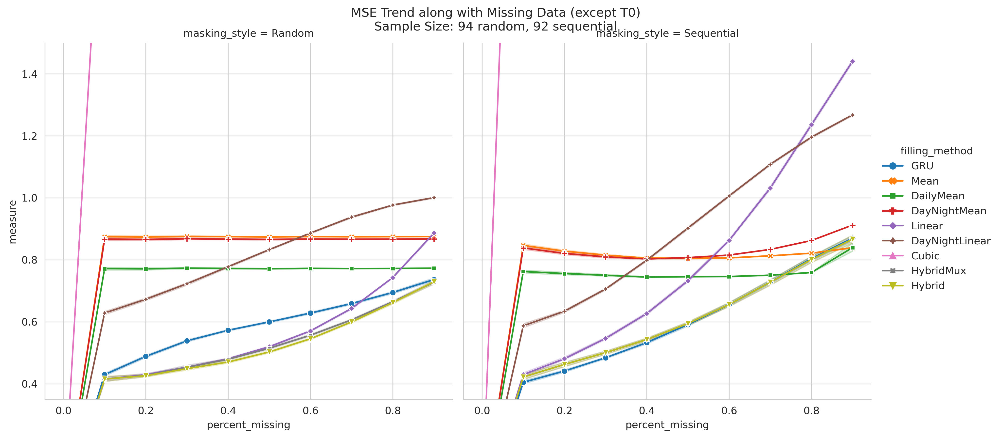

In [12]:
plot_trend(
    build_df(dicts_fill_random_MSE, dicts_fill_sequential_MSE), 
    "MSE Trend along with Missing Data (except T0)\nSample Size: {0} random, {1} sequential".format(
        sample_size(MSE_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH), 
        sample_size(MSE_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH), 
    ), 
    (0.35, 1.5)
)
# plot_trend(build_df(dicts_fill_random_MSE, dicts_fill_sequential_MSE), "MSE Trend along with Missing Data (except T0)", None)

In [13]:
build_df_RMSE(dicts_fill_random_MSE, dicts_fill_sequential_MSE)

,percent_missing,masking_style,filling_method,measure
0,0.0,Random,GRU,0.000000
1,0.1,Random,GRU,0.644965
2,0.2,Random,GRU,0.699128
3,0.3,Random,GRU,0.737022
4,0.4,Random,GRU,0.767485
...,...,...,...,...
14535,0.5,Sequential,Hybrid,0.774439
14536,0.6,Sequential,Hybrid,0.822113
14537,0.7,Sequential,Hybrid,0.863027
14538,0.8,Sequential,Hybrid,0.913779


/tmp/ipykernel_1345111/3999989867.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_2 = df_RMSE[(df_RMSE["Filling Methods"] != "HybridMux")][(df_RMSE["Filling Methods"] != "DayNightMean")][(df_RMSE["Filling Methods"] != "Cubic")][(df_RMSE["Filling Methods"] != "DayNightLinear")]


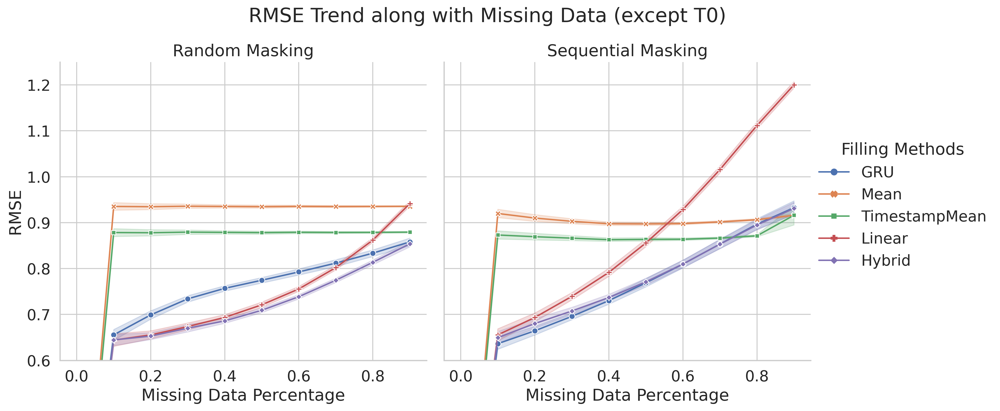

In [20]:
sns.set(font_scale = 1.4)
sns.set_style("whitegrid")

df_RMSE = build_df_RMSE(dicts_fill_random_MSE, dicts_fill_sequential_MSE)

df_RMSE = df_RMSE.rename(columns={"filling_method": "Filling Methods"})

df_2 = df_RMSE[(df_RMSE["Filling Methods"] != "HybridMux")][(df_RMSE["Filling Methods"] != "DayNightMean")][(df_RMSE["Filling Methods"] != "Cubic")][(df_RMSE["Filling Methods"] != "DayNightLinear")]

df_2["Filling Methods"] = np.where(df_2["Filling Methods"]=="DailyMean", "TimestampMean", df_2["Filling Methods"])

g = sns.relplot(
    data=df_2,
    x="percent_missing", 
    y="measure", 
    hue="Filling Methods",
    style="Filling Methods", 
    col="masking_style",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
).set(
    ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="RMSE",
)
g.fig.subplots_adjust(top=.85)
g.fig.suptitle(
    "RMSE Trend along with Missing Data (except T0)"
)
g.set_titles("{col_name} Masking")
plt.show()

In [15]:
sns.set_theme(font_scale = 1.4)
sns.set_style("whitegrid")

df_RMSE = build_df_RMSE(dicts_fill_random_MSE, dicts_fill_sequential_MSE)

df_RMSE = df_RMSE.rename(columns={"filling_method": "Filling Methods"})
df_RMSE[df_RMSE["Filling Methods"] == "DailyMean"] = "TimestampMean"

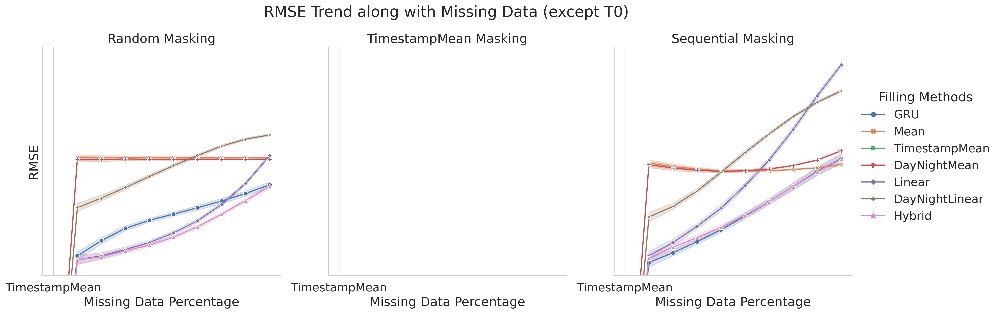

In [16]:

g = sns.relplot(
    data=df_RMSE[(df_RMSE["Filling Methods"] != "HybridMux") & (df_RMSE["Filling Methods"] != "Cubic")],
    x="percent_missing", 
    y="measure", 
    hue="Filling Methods",
    style="Filling Methods", 
    col="masking_style",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
).set(
    ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="RMSE",
)
g.figure.subplots_adjust(top=.85)
g.figure.suptitle(
    "RMSE Trend along with Missing Data (except T0)"
)
g.set_titles("{col_name} Masking")
plt.show()

## MAE

In [17]:
dicts_fill_random_MAE = load_dfs(MAE_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH)
dicts_fill_sequential_MAE = load_dfs(MAE_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH)

/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)


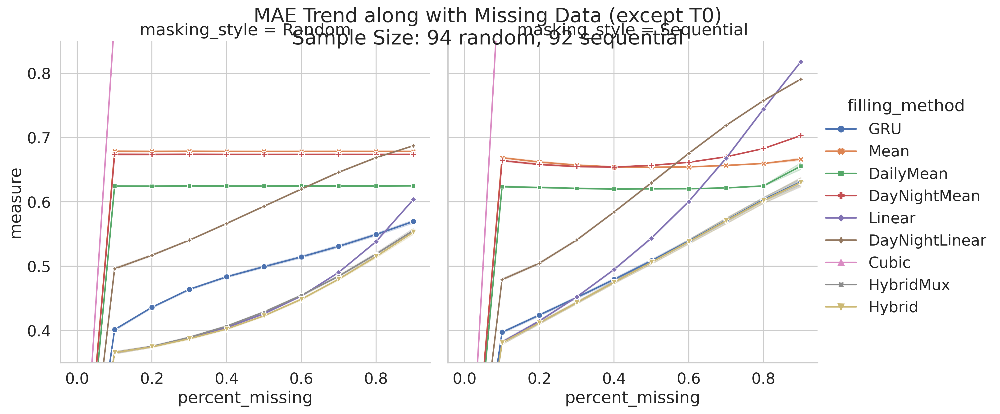

In [18]:
plot_trend(
    build_df(dicts_fill_random_MAE, dicts_fill_sequential_MAE), 
    "MAE Trend along with Missing Data (except T0)\nSample Size: {0} random, {1} sequential".format(
        sample_size(MAE_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH), 
        sample_size(MAE_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH), 
    ),
    (0.35, 0.85)
)
# plot_trend(build_df(dicts_fill_random_MAE, dicts_fill_sequential_MAE), "MAE Trend along with Missing Data (except T0)", None)

## GRU

In [19]:
dicts_fill_random_GRU = load_dfs(GRU_RVAL_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH)
dicts_fill_sequential_GRU = load_dfs(GRU_RVAL_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH)

/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)


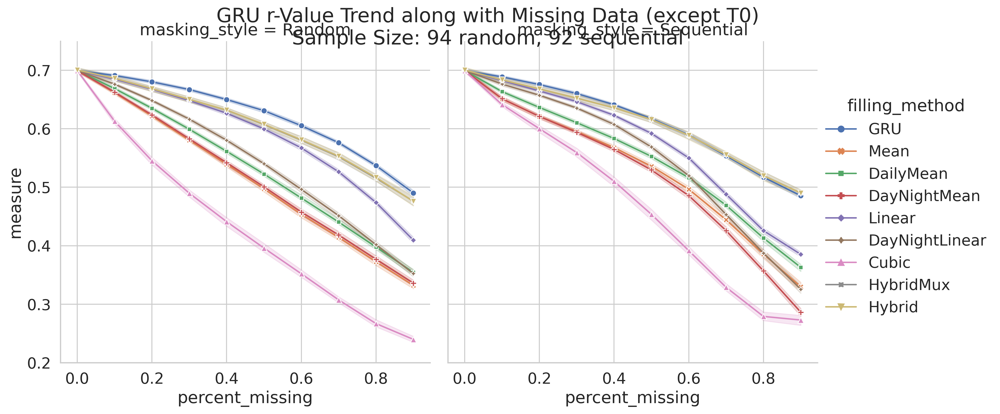

In [20]:
plot_trend(
    build_df(dicts_fill_random_GRU, dicts_fill_sequential_GRU), 
    "GRU r-Value Trend along with Missing Data (except T0)\nSample Size: {0} random, {1} sequential".format(
        sample_size(GRU_RVAL_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH), 
        sample_size(GRU_RVAL_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH), 
    ), 
    (0.2, 0.75)
)
# plot_trend(build_df(dicts_fill_random_GRU, dicts_fill_sequential_GRU), "GRU r-Value Trend along with Missing Data (except T0)", None)

## FC

In [21]:
dicts_fill_random_FC = load_dfs(FC_RVAL_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH)
dicts_fill_sequential_FC = load_dfs(FC_RVAL_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH)

/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)


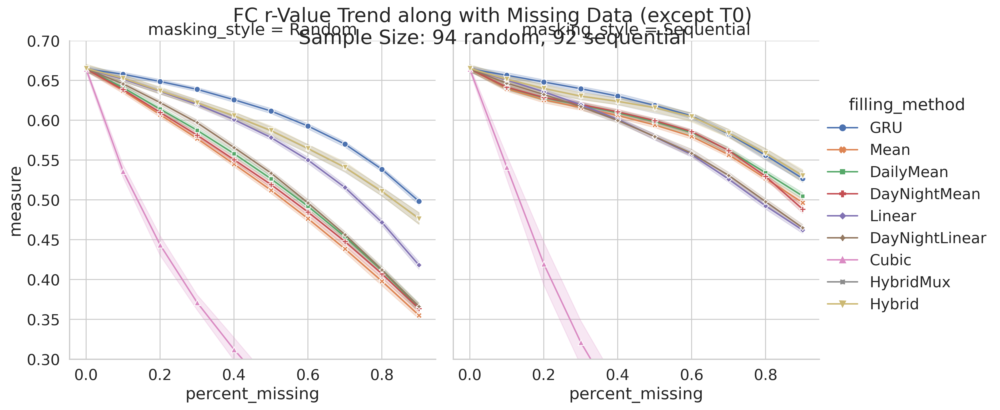

In [22]:
plot_trend(
    build_df(dicts_fill_random_FC, dicts_fill_sequential_FC), 
    "FC r-Value Trend along with Missing Data (except T0)\nSample Size: {0} random, {1} sequential".format(
        sample_size(FC_RVAL_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH), 
        sample_size(FC_RVAL_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH), 
    ), 
    (0.3, 0.7))
# plot_trend(build_df(dicts_fill_random_FC, dicts_fill_sequential_FC), "FC r-Value Trend along with Missing Data (except T0)", None)

## LINEAR

In [23]:
dicts_fill_random_LINEAR = load_dfs(LINEAR_RVAL_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH)
dicts_fill_sequential_LINEAR = load_dfs(LINEAR_RVAL_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH)

/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/disk/eos1/liuzihui/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 100)` for the same effect.

  func(*plot_args, **plot_kwargs)


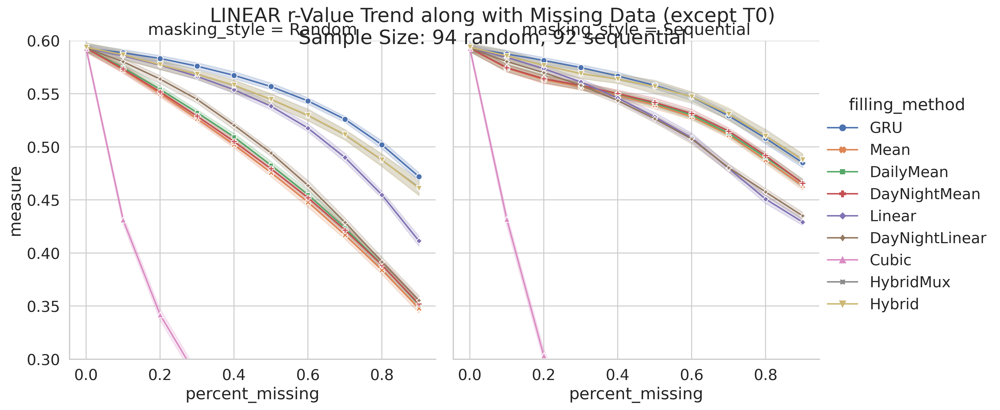

In [24]:
plot_trend(
    build_df(dicts_fill_random_LINEAR, dicts_fill_sequential_LINEAR), 
    "LINEAR r-Value Trend along with Missing Data (except T0)\nSample Size: {0} random, {1} sequential".format(
        sample_size(LINEAR_RVAL_FILE_PREFIX, FC_OUTPUT_FOLDER_PATH), 
        sample_size(LINEAR_RVAL_FILE_PREFIX, FC_REAL_OUTPUT_FOLDER_PATH), 
    ), 
    (0.3, 0.6)
)
# plot_trend(build_df(dicts_fill_random_LINEAR, dicts_fill_sequential_LINEAR), "LINEAR r-Value Trend along with Missing Data (except T0)", None)

## Rebuild Data Training Stats

In [25]:
df_rebuid = pd.concat(load_dfs(REBUILD_STATS_FILE_PREFIX, FC_REBUILD_OUTPUT_PATH), ignore_index=True)

df_rebuid = pd.melt(
    frame=df_rebuid, 
    id_vars=["filling_method", "missing_percent", "masking_type", "benchmark_method"],
    value_vars=["r_train", "r_test", "r_final_test"],
    value_name="r_value",
    var_name="r_value_type",
    ignore_index=True
)

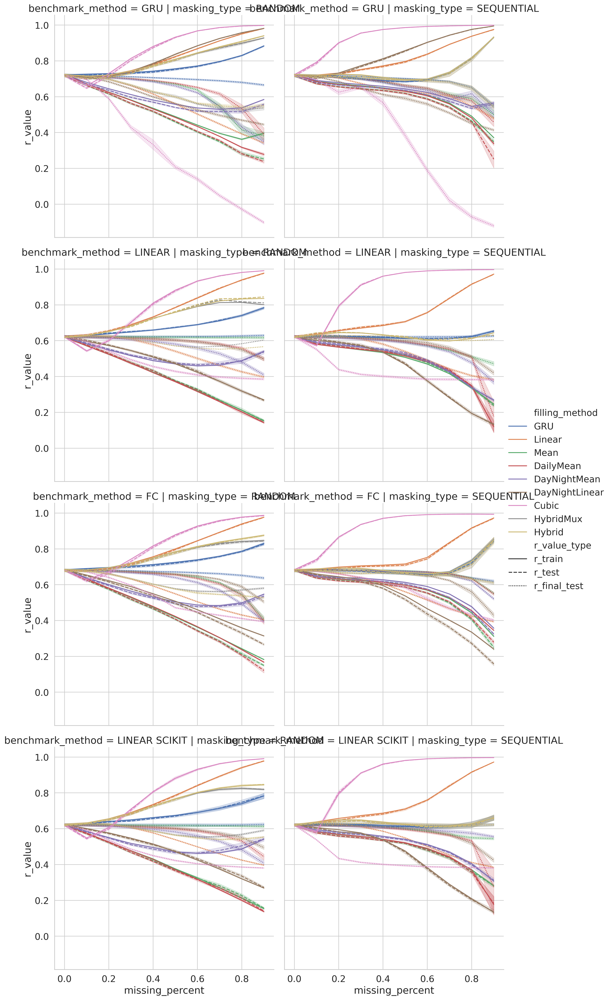

In [26]:
sns.relplot(
    data=df_rebuid,
    x="missing_percent",
    y="r_value",
    hue="filling_method",
    style="r_value_type",
    col="masking_type",
    row="benchmark_method",
    kind="line", 
    height=6,
    aspect=1
)
plt.show()

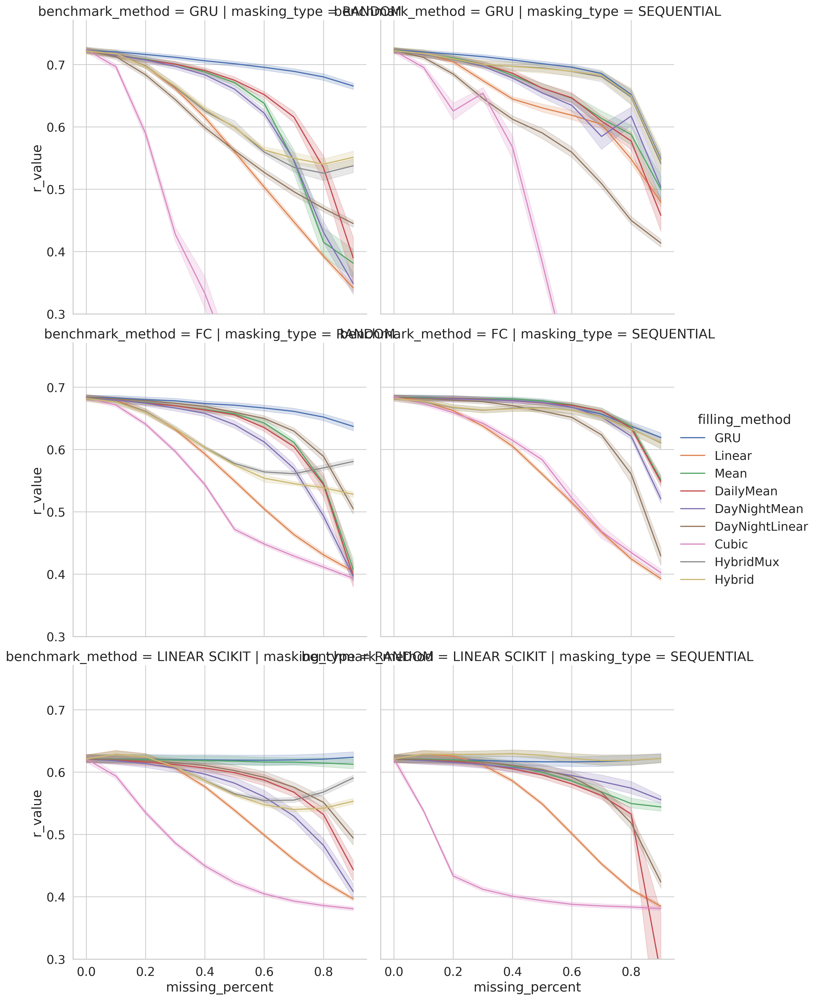

In [27]:
g = sns.relplot(
    data=df_rebuid[(df_rebuid["r_value_type"] == "r_final_test") & (df_rebuid["benchmark_method"] != "LINEAR")],
    x="missing_percent",
    y="r_value",
    hue="filling_method",
    col="masking_type",
    row="benchmark_method",
    kind="line", 
    height=6,
    aspect=1
)
g.set(ylim=(.3, None))
plt.show()

In [28]:
USING_STANDARD_DIVIATION = False

OUTPUT_FOLDER = pathlib.Path("Output/filling_comp_separate_vars_sd_metric") if USING_STANDARD_DIVIATION else pathlib.Path("Output/filling_comp_separate_vars")


RANDOM_DATA_FOLDER_PATH = OUTPUT_FOLDER / "filling_comparison/"
RANDOM_DATA_FOLDER_ARCHIVE = utl.Archive(RANDOM_DATA_FOLDER_PATH)

REALISTIC_DATA_OUTPUT_FOLDER_PATH = OUTPUT_FOLDER / "filling_comparison_realistic/"
REALISTIC_DATA_OUTPUT_FOLDER_PATH_ARCHIVE = utl.Archive(REALISTIC_DATA_OUTPUT_FOLDER_PATH)

In [29]:
def get_param_result_file_name(archive:utl.Archive, prefix):
    return [
        name
        for name in os.listdir(archive.file_path)
        if name.startswith(prefix)
    ]
    

In [30]:
PARAMETER_NAME_LIST = ["LTS", "SST", "Subsidence", "Night_Day", "RH", "q", "wsp", "TCC"]

In [31]:
def load_param_result_file(archive:utl.Archive, file_name): 
    d = archive.load_data(file_name)
    
    filling_name_list = list(d.keys())
    filling_name_list.remove('PercentMissing')

    df_filling_res = []

    for idx_param, param_name in enumerate(PARAMETER_NAME_LIST):
        d_param = {}
        d_param['PercentMissing'] = d['PercentMissing']
        
        for filling_name in filling_name_list:   
            
            err = np.array(d[filling_name])[:, idx_param]
            d_param[filling_name] = err
        
        df_param = pd.DataFrame(d_param)
        df_param["Parameter"] = param_name
        
        df_filling_res.append(df_param)
        
    return pd.concat(df_filling_res, axis=0, ignore_index=True)

In [32]:
def get_MAE_parameter_error_file(archive:utl.Archive):
    return pd.concat(
        [
            load_param_result_file(archive, file_name)
            for file_name in get_param_result_file_name(archive, "FILL_MAE_")
        ],
        axis=0,
        ignore_index=True,
    )
def get_MSE_parameter_error_file(archive:utl.Archive):
    return pd.concat(
        [
            load_param_result_file(archive, file_name)
            for file_name in get_param_result_file_name(archive, "FILL_MSE_")
        ],
        axis=0,
        ignore_index=True,
    )

In [33]:
df_MAE_Sequencial = get_MAE_parameter_error_file(REALISTIC_DATA_OUTPUT_FOLDER_PATH_ARCHIVE)
df_MAE_Sequencial["Mask Strategy"] = "Sequencial"
df_MAE_Sequencial["Metric"] = "MAE"

df_MSE_Sequencial = get_MSE_parameter_error_file(REALISTIC_DATA_OUTPUT_FOLDER_PATH_ARCHIVE)
df_MSE_Sequencial["Mask Strategy"] = "Sequencial"
df_MSE_Sequencial["Metric"] = "MSE"

df_MAE_Random = get_MAE_parameter_error_file(RANDOM_DATA_FOLDER_ARCHIVE)
df_MAE_Random["Mask Strategy"] = "Random"
df_MAE_Random["Metric"] = "MAE"

df_MSE_Random = get_MSE_parameter_error_file(RANDOM_DATA_FOLDER_ARCHIVE)
df_MSE_Random["Mask Strategy"] = "Random"
df_MSE_Random["Metric"] = "MSE"

df_res = pd.concat([df_MAE_Sequencial, df_MSE_Sequencial, df_MAE_Random, df_MSE_Random], axis=0, ignore_index=True)

df_res = df_res.melt(
    id_vars=["PercentMissing" , 'Parameter', 'Mask Strategy', 'Metric'],
    value_name="Error",
    var_name="Filling Method"
)

df_rmse = df_res.copy()
df_rmse["Error"] = np.sqrt(df_rmse["Error"])
df_rmse = df_rmse[df_rmse["Metric"] == "MSE"]

In [34]:
# sns.set(font_scale = 1)
# sns.set_style("whitegrid")


# g = sns.relplot(
#     # data=df_res[df_res["Parameter"] != "Night_Day"],
#     data=df_res,
#     x="PercentMissing", 
#     y="Error", 
#     hue="Filling Method",
#     style="Filling Method", 
#     col="Metric",
#     row="Parameter",
#     markers=True, 
#     dashes=False, 
#     kind="line",
#     # errorbar=lambda a: (np.min(a), np.max(a)),
#     errorbar=('sd', 1),
#     height=6,
#     aspect=1,
#     facet_kws={'sharey': False, 'sharex': True}
# ).set(
#     # ylim=(0.6, 1.25),
#     xlabel="Missing Data Percentage",
#     ylabel="Error",
# )
# g.fig.subplots_adjust(top=.96)
# g.fig.suptitle(
#     "Error Trend along with Missing Data"
# )
# g.set_titles("{col_name}, {row_name}")
# plt.show()

In [35]:
# sns.set(font_scale = 1)
# sns.set_style("whitegrid")


# g = sns.relplot(
#     data=df_res[df_res["Metric"] == "MSE"],
#     # data=df_res,
#     x="PercentMissing", 
#     y="Error", 
#     hue="Filling Method",
#     style="Filling Method", 
#     col="Parameter",
#     col_wrap=3,
#     # row="Parameter",
#     markers=True, 
#     dashes=False, 
#     kind="line",
#     # errorbar=lambda a: (np.min(a), np.max(a)),
#     errorbar=('sd', 1),
#     height=6,
#     aspect=1,
#     facet_kws={'sharey': True, 'sharex': True}
# ).set(
#     # ylim=(0.6, 1.25),
#     xlabel="Missing Data Percentage",
#     ylabel="Error",
# )
# g.fig.subplots_adjust(top=.94)
# g.fig.suptitle(
#     "MSE Trend along with Missing Data"
# )
# # g.set_titles("{col_name}, {row_name}")
# plt.show()

In [36]:


# sns.set(font_scale = 1)
# sns.set_style("whitegrid")


# g = sns.relplot(
#     data=df_rmse,
#     # data=df_res,
#     x="PercentMissing", 
#     y="Error", 
#     hue="Filling Method",
#     style="Filling Method", 
#     col="Parameter",
#     col_wrap=3,
#     # row="Parameter",
#     markers=True, 
#     dashes=False, 
#     kind="line",
#     # errorbar=lambda a: (np.min(a), np.max(a)),
#     errorbar=('sd', 1),
#     height=6,
#     aspect=1,
#     facet_kws={'sharey': False, 'sharex': True}
# ).set(
#     # ylim=(0.6, 1.25),
#     xlabel="Missing Data Percentage",
#     ylabel="Error",
# )
# g.fig.subplots_adjust(top=.94)
# g.fig.suptitle(
#     "RMSE Trend along with Missing Data"
# )
# # g.set_titles("{col_name}, {row_name}")
# plt.show()

## by Masking Style

In [37]:
sns.set(font_scale = 1)
sns.set_style("whitegrid")


g = sns.relplot(
    data=df_rmse,
    x="PercentMissing", 
    y="Error", 
    hue="Filling Method",
    style="Filling Method", 
    col="Mask Strategy",
    row="Parameter",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
    facet_kws={'sharey': False, 'sharex': True}
).set(
    # ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="Error",
)
g.fig.subplots_adjust(top=.96)
g.fig.suptitle(
    "RMSE Trend along with Missing Data"
)
g.set_titles("{col_name}, {row_name}")
plt.show()

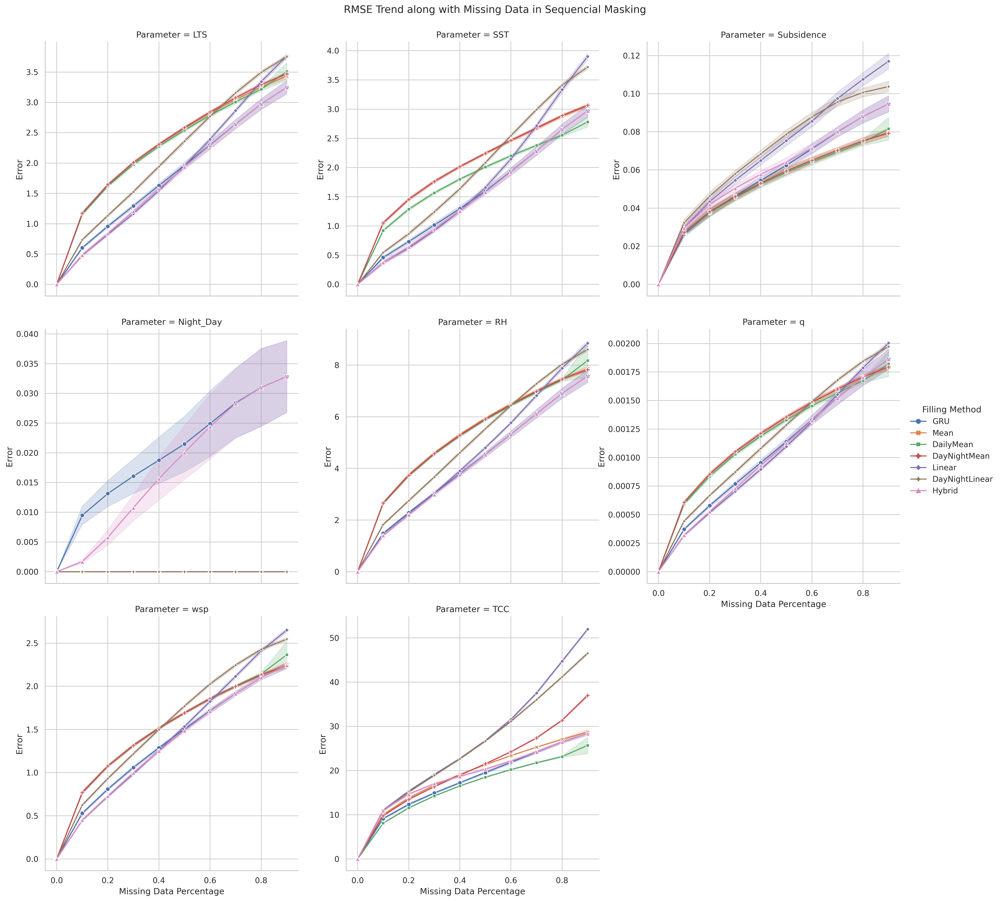

In [38]:


sns.set(font_scale = 1)
sns.set_style("whitegrid")


g = sns.relplot(
    data=df_rmse[df_rmse["Mask Strategy"] == "Sequencial"],
    # data=df_res,
    x="PercentMissing", 
    y="Error", 
    hue="Filling Method",
    style="Filling Method", 
    col="Parameter",
    col_wrap=3,
    # row="Parameter",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
    facet_kws={'sharey': False, 'sharex': True}
).set(
    # ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="Error",
)
g.fig.subplots_adjust(top=.94)
g.fig.suptitle(
    "RMSE Trend along with Missing Data in Sequencial Masking"
)
# g.set_titles("{col_name}, {row_name}")
plt.show()

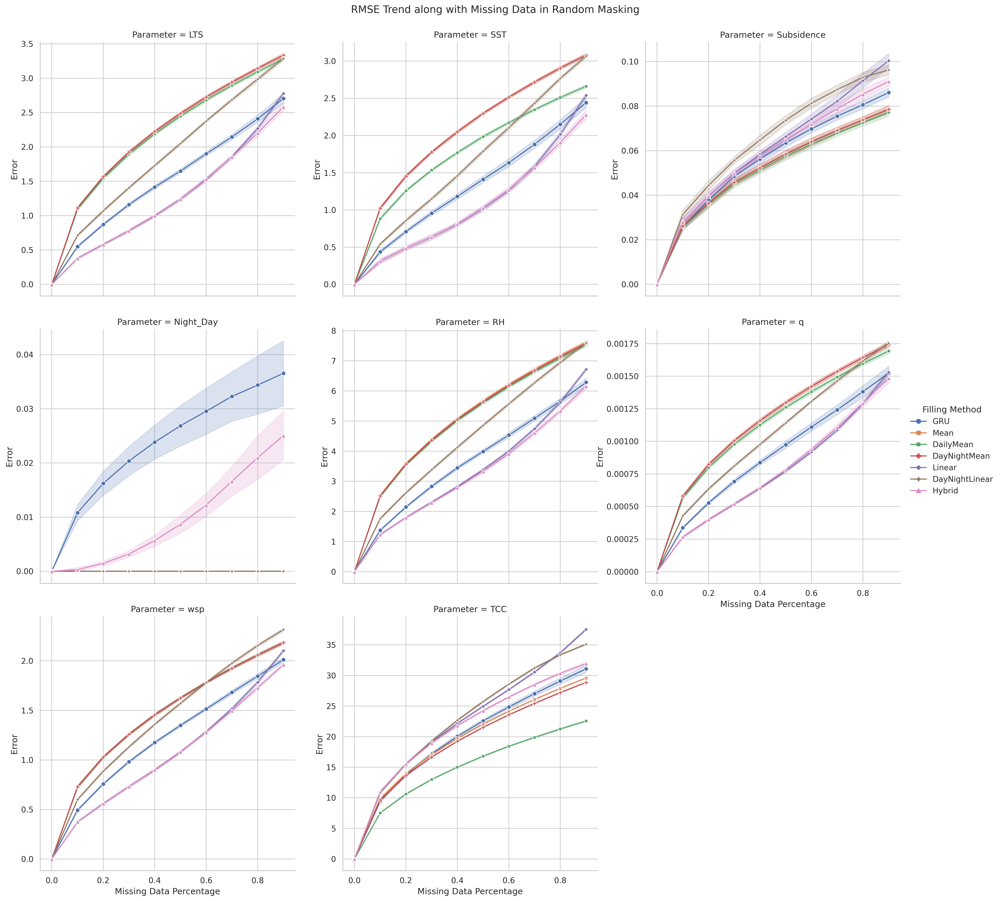

In [39]:
sns.set(font_scale = 1)
sns.set_style("whitegrid")


g = sns.relplot(
    data=df_rmse[df_rmse["Mask Strategy"] == "Random"],
    # data=df_res,
    x="PercentMissing", 
    y="Error", 
    hue="Filling Method",
    style="Filling Method", 
    col="Parameter",
    col_wrap=3,
    # row="Parameter",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
    facet_kws={'sharey': False, 'sharex': True}
).set(
    # ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="Error",
)
g.fig.subplots_adjust(top=.94)
g.fig.suptitle(
    "RMSE Trend along with Missing Data in Random Masking"
)
# g.set_titles("{col_name}, {row_name}")
plt.show()

# by SD

In [40]:
USING_STANDARD_DIVIATION = True

OUTPUT_FOLDER = pathlib.Path("Output/filling_comp_separate_vars_sd_metric") if USING_STANDARD_DIVIATION else pathlib.Path("Output/filling_comp_separate_vars")


RANDOM_DATA_FOLDER_PATH = OUTPUT_FOLDER / "filling_comparison/"
RANDOM_DATA_FOLDER_ARCHIVE = utl.Archive(RANDOM_DATA_FOLDER_PATH)

REALISTIC_DATA_OUTPUT_FOLDER_PATH = OUTPUT_FOLDER / "filling_comparison_realistic/"
REALISTIC_DATA_OUTPUT_FOLDER_PATH_ARCHIVE = utl.Archive(REALISTIC_DATA_OUTPUT_FOLDER_PATH)


df_MAE_Sequencial = get_MAE_parameter_error_file(REALISTIC_DATA_OUTPUT_FOLDER_PATH_ARCHIVE)
df_MAE_Sequencial["Mask Strategy"] = "Sequencial"
df_MAE_Sequencial["Metric"] = "MAE"

df_MSE_Sequencial = get_MSE_parameter_error_file(REALISTIC_DATA_OUTPUT_FOLDER_PATH_ARCHIVE)
df_MSE_Sequencial["Mask Strategy"] = "Sequencial"
df_MSE_Sequencial["Metric"] = "MSE"

df_MAE_Random = get_MAE_parameter_error_file(RANDOM_DATA_FOLDER_ARCHIVE)
df_MAE_Random["Mask Strategy"] = "Random"
df_MAE_Random["Metric"] = "MAE"

df_MSE_Random = get_MSE_parameter_error_file(RANDOM_DATA_FOLDER_ARCHIVE)
df_MSE_Random["Mask Strategy"] = "Random"
df_MSE_Random["Metric"] = "MSE"

df_res = pd.concat([df_MAE_Sequencial, df_MSE_Sequencial, df_MAE_Random, df_MSE_Random], axis=0, ignore_index=True)

df_res = df_res.melt(
    id_vars=["PercentMissing" , 'Parameter', 'Mask Strategy', 'Metric'],
    value_name="Error",
    var_name="Filling Method"
)

df_rmse = df_res.copy()
df_rmse["Error"] = np.sqrt(df_rmse["Error"])
df_rmse = df_rmse[df_rmse["Metric"] == "MSE"]

In [41]:
sns.set(font_scale = 1)
sns.set_style("whitegrid")


g = sns.relplot(
    data=df_rmse,
    x="PercentMissing", 
    y="Error", 
    hue="Filling Method",
    style="Filling Method", 
    col="Mask Strategy",
    row="Parameter",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
    facet_kws={'sharey': True, 'sharex': True}
).set(
    # ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="Error",
)
g.fig.subplots_adjust(top=.96)
g.fig.suptitle(
    "RMSE Trend along with Missing Data, in SD Unit"
)
g.set_titles("{col_name}, {row_name}")
plt.show()

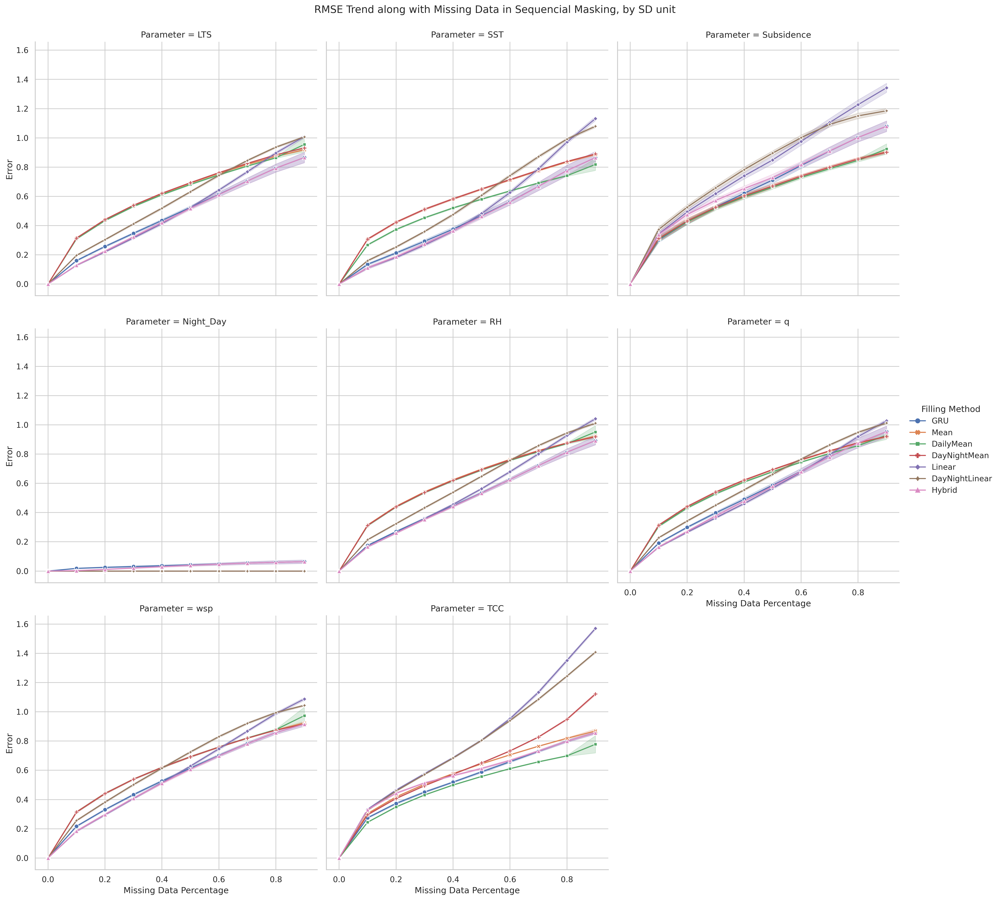

In [42]:


sns.set(font_scale = 1)
sns.set_style("whitegrid")


g = sns.relplot(
    data=df_rmse[df_rmse["Mask Strategy"] == "Sequencial"],
    # data=df_res,
    x="PercentMissing", 
    y="Error", 
    hue="Filling Method",
    style="Filling Method", 
    col="Parameter",
    col_wrap=3,
    # row="Parameter",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
    facet_kws={'sharey': True, 'sharex': True}
).set(
    # ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="Error",
)
g.fig.subplots_adjust(top=.94)
g.fig.suptitle(
    "RMSE Trend along with Missing Data in Sequencial Masking, by SD unit"
)
# g.set_titles("{col_name}, {row_name}")
plt.show()

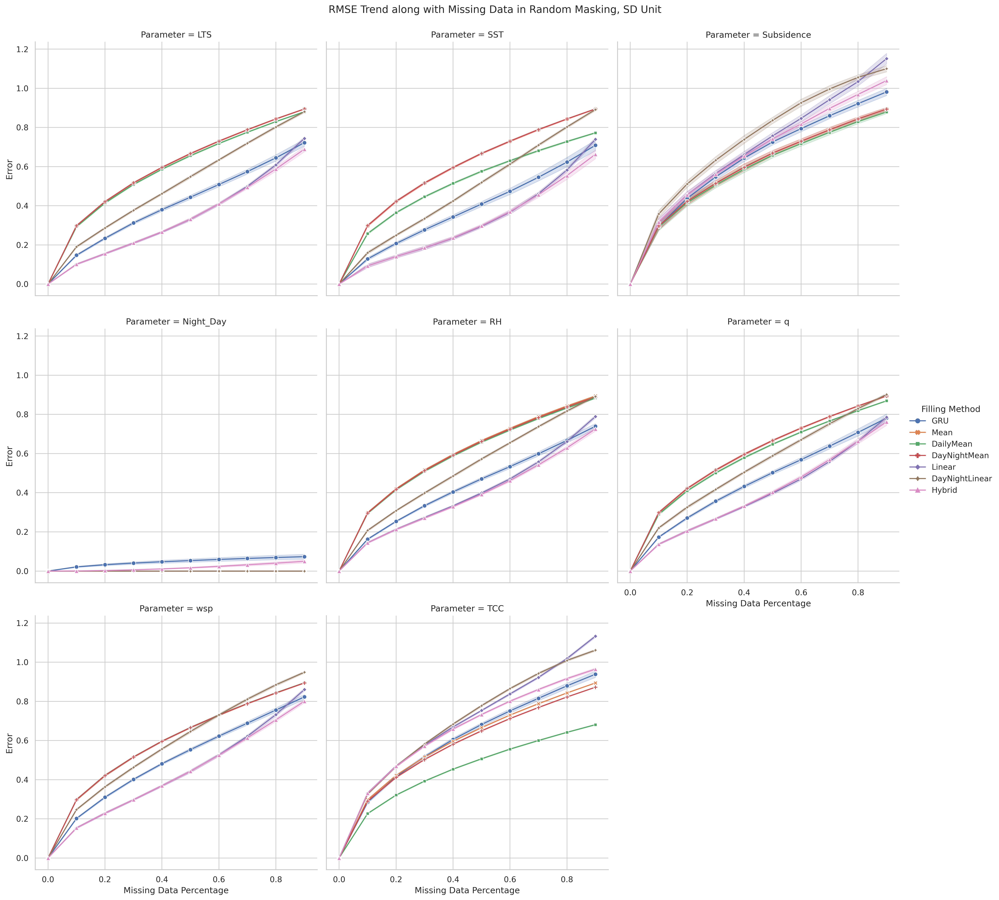

In [43]:
sns.set(font_scale = 1)
sns.set_style("whitegrid")


g = sns.relplot(
    data=df_rmse[df_rmse["Mask Strategy"] == "Random"],
    # data=df_res,
    x="PercentMissing", 
    y="Error", 
    hue="Filling Method",
    style="Filling Method", 
    col="Parameter",
    col_wrap=3,
    # row="Parameter",
    markers=True, 
    dashes=False, 
    kind="line",
    # errorbar=lambda a: (np.min(a), np.max(a)),
    errorbar=('sd', 1),
    height=6,
    aspect=1,
    facet_kws={'sharey': True, 'sharex': True}
).set(
    # ylim=(0.6, 1.25),
    xlabel="Missing Data Percentage",
    ylabel="Error",
)
g.fig.subplots_adjust(top=.94)
g.fig.suptitle(
    "RMSE Trend along with Missing Data in Random Masking, SD Unit"
)
# g.set_titles("{col_name}, {row_name}")
plt.show()